## Notebook for exploratory analysis of Human Gut Stem cells scRNA-Seq data using `scVI` and `SCCAF-leiden`

- **Developed by**: Carlos Talavera-López Ph.D
- **Institute of Computational Biology - Computational Health Centre - Helmholtz Munich**
- v230315

### Load required modules

In [1]:
import sys
import scvi
import torch
import anndata
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns

import numpy as np
import scipy as sp
import pandas as pd
import scanpy as sc
import numpy.random as random


from umap import UMAP
import warnings; warnings.simplefilter('ignore')

import matplotlib.pyplot as plt

/Users/cartalop/mambaforge/envs/scvi-tools/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Global seed set to 0
/Users/cartalop/mambaforge/envs/scvi-tools/lib/python3.9/site-packages/flax/struct.py:133: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.register_keypaths(data_clz, keypaths)
/Users/cartalop/mambaforge/envs/scvi-tools/lib/python3.9/site-packages/flax/struct.py:133: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.register_keypaths(data_clz, keypaths)
/Users/cartalop/mambaforge/envs/scvi-tools/lib/python3.9/site-packages/flax/struct.py:133: FutureWarning: j

In [2]:
save_path = "../data/"

In [3]:
%matplotlib inline
matplotlib.rcParams["pdf.fonttype"] = 42
matplotlib.rcParams["ps.fonttype"] = 42

In [4]:
torch.cuda.is_available()

False

In [5]:
torch.set_float32_matmul_precision('medium')

In [6]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.8.0
scanpy      1.9.3
-----
PIL                 9.4.0
absl                NA
appnope             0.1.3
asttokens           NA
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
brotli              NA
certifi             2022.12.07
cffi                1.15.1
charset_normalizer  2.1.1
chex                0.1.6
colorama            0.4.6
contextlib2         NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.6
decorator           5.1.1
docrep              0.3.2
executing           1.2.0
flax                0.5.0
fsspec              2023.3.0
h5py                3.8.0
hypergeom_ufunc     NA
idna                3.4
igraph              0.10.4
importlib_resources NA
invgauss_ufunc      NA
ipykernel           6.15.0
jax                 0.4.6
jaxlib              0.4.6
jedi                0.18.2
joblib              1.2.0
kiwisolver          1.4.4
leidenalg           0.9.1
lightning_fabric    1.9.4
lightning

In [7]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

### Read in datasets

- Read in formatted object

In [8]:
gut_stem = sc.read_h5ad('../data/Predicted_stem_cells.h5ad')
gut_stem

AnnData object with n_obs × n_vars = 14938 × 40144
    obs: 'UniqueCell_ID', 'Sample_ID', 'CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts_mt', 'doublet_scores', 'predicted_doublets', 'Age_group', 'total_counts_ribo', 'Location', 'n_counts', 'percent_mito', 'percent_ribo', 'Cell States', 'Cell Label'

In [9]:
sc.pp.filter_genes(gut_stem, min_counts = 1)
sc.pp.filter_genes(gut_stem, min_cells = 3)

sc.pp.filter_cells(gut_stem, min_genes = 50)
sc.pp.filter_cells(gut_stem, min_counts = 3)

filtered out 11320 genes that are detected in less than 1 counts
filtered out 4187 genes that are detected in less than 3 cells


In [10]:
gut_stem.obs['Study_name'].cat.categories

Index(['Gut Cell Atlas', 'Smilie', 'Wang'], dtype='object')

In [11]:
X_is_raw(gut_stem)

True

### Calculate HVGs

In [12]:
gut_stem_raw = gut_stem.copy()
gut_stem.layers['counts'] = gut_stem.X.copy()

In [13]:
sc.pp.highly_variable_genes(
    gut_stem,
    flavor = "seurat_v3",
    n_top_genes = 7000,
    layer = "counts",
    batch_key = "Fraction",
    subset = True,
    span = 1
)
gut_stem

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 14938 × 7000
    obs: 'UniqueCell_ID', 'Sample_ID', 'CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts_mt', 'doublet_scores', 'predicted_doublets', 'Age_group', 'total_counts_ribo', 'Location', 'n_counts', 'percent_mito', 'percent_ribo', 'Cell States', 'Cell Label'
    var: 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg'
    layers: 'counts'

### Data integration with `scVI`

In [14]:
scvi.model.SCVI.setup_anndata(
    gut_stem,
    layer = "counts",
    categorical_covariate_keys = ["Fraction"],
    continuous_covariate_keys = ["n_genes", "n_counts"]
)

In [15]:
model = scvi.model.SCVI(gut_stem, n_layers = 3, n_latent = 50, gene_likelihood = "nb", dispersion = 'gene-batch')
model

SCVI Model with the following params: 
n_hidden: 128, n_latent: 50, n_layers: 3, dropout_rate: 0.1, dispersion: gene-batch, gene_likelihood: nb, 
latent_distribution: normal
Training status: Not Trained
Model's adata is minified?: False

In [16]:
model.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 400/400: 100%|██████████| 400/400 [1:02:31<00:00,  9.26s/it, loss=2.05e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████| 400/400 [1:02:31<00:00,  9.38s/it, loss=2.05e+03, v_num=1]


In [17]:
latent = model.get_latent_representation()
gut_stem.obsm["X_scVI"] = latent

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


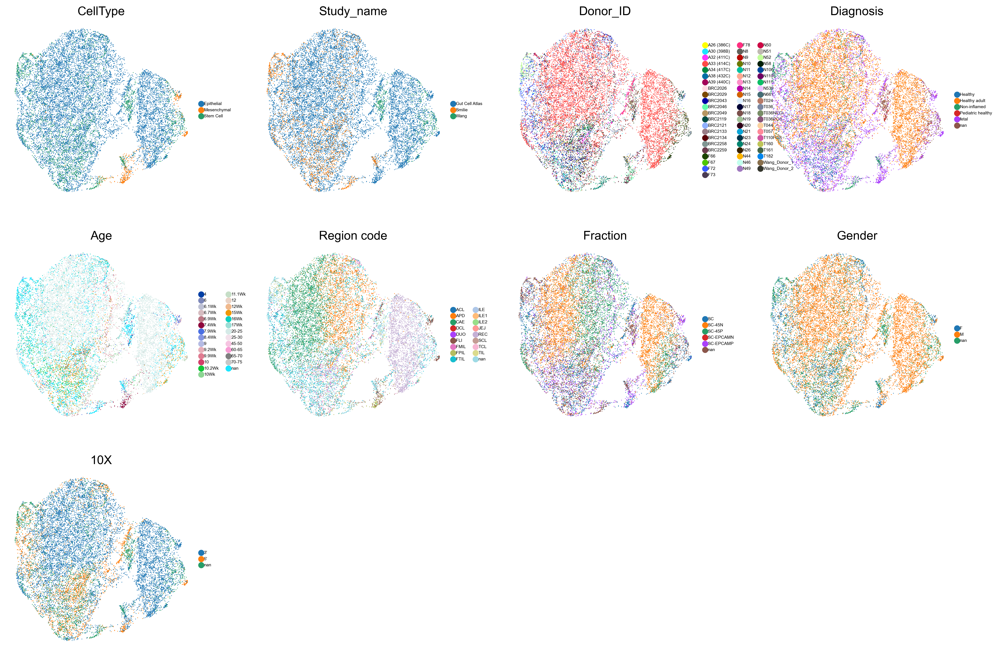

In [18]:
sc.pp.neighbors(gut_stem, use_rep = "X_scVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(gut_stem, min_dist = 0.3, spread = 1, random_state = 1712)
sc.pl.umap(gut_stem, frameon = False, color = ['CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X'], size = 3, legend_fontsize = 5, ncols = 4)

### Cluster manifold using `leiden` + `SCCAF`

In [27]:
from SCCAF import SCCAF_assessment, plot_roc
sc.tl.leiden(gut_stem, resolution = 0.12, random_state = 1786)

running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


Mean CV accuracy: 0.7425
Accuracy on the training set: 0.9975
Accuracy on the hold-out set: 0.6995


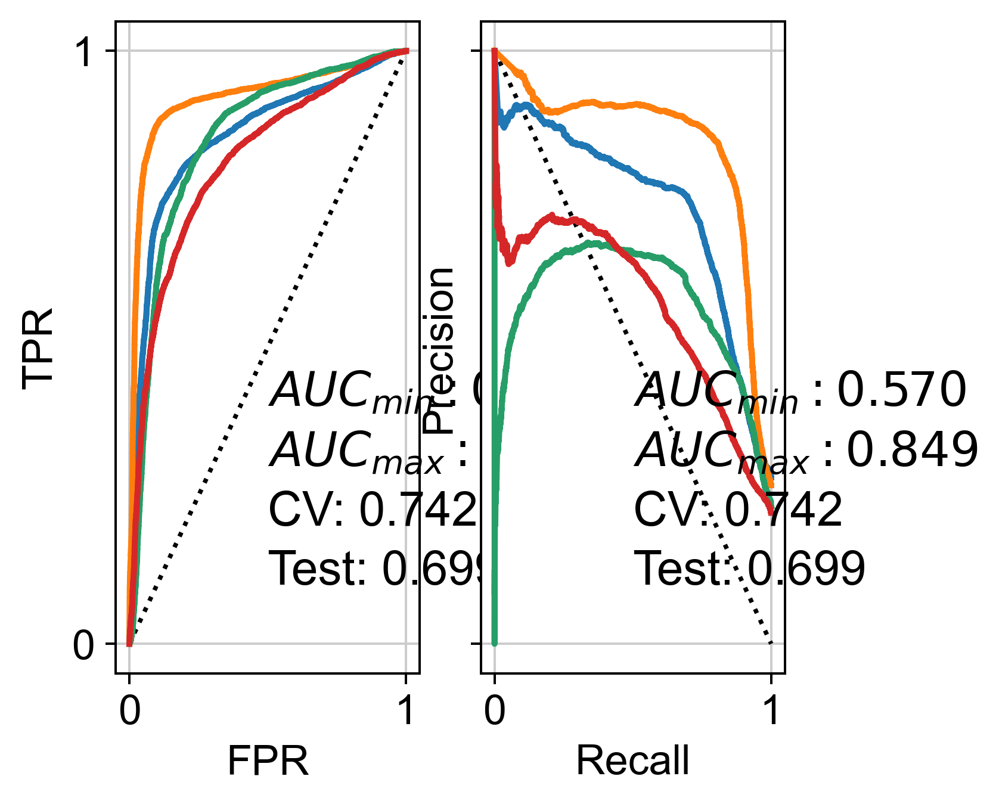

In [28]:
y_prob, y_pred, y_test, clf, cvsm, acc = SCCAF_assessment(gut_stem.X, gut_stem.obs['leiden'], n = 100)
plot_roc(y_prob, y_test, clf, cvsm = cvsm, acc = acc)
plt.show()

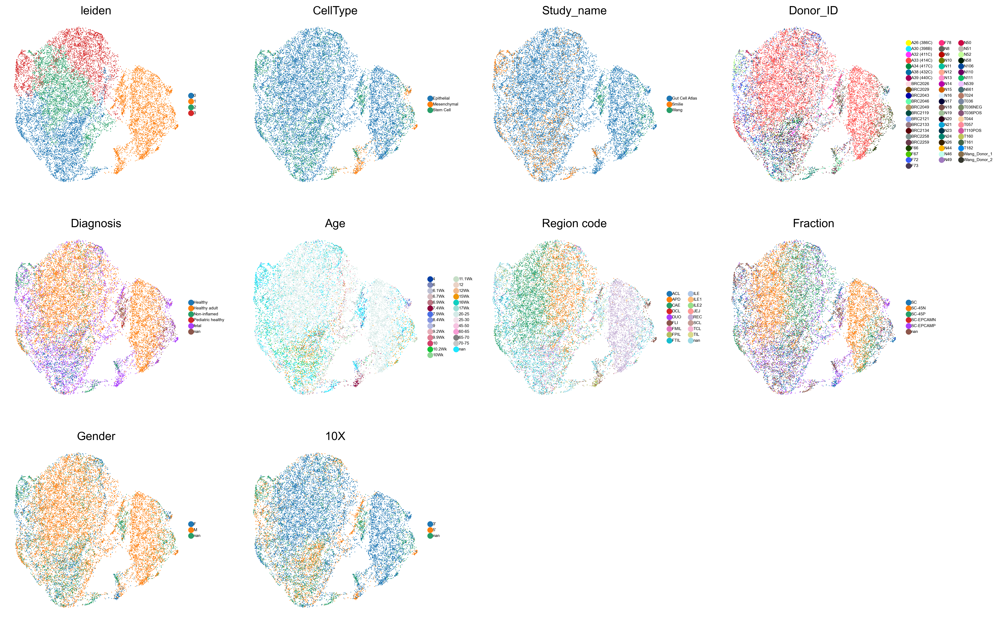

In [29]:
sc.pl.umap(gut_stem, frameon = False, color = ['leiden', 'CellType', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', '10X'], size = 3, legend_fontsize = 5, ncols = 4)